In [1]:
from IPython.display import Audio
import wave
import numpy as np
import matplotlib.pyplot as plt

sampwidth_dtype_unsigned = {
    1: np.uint8,
    2: np.uint16,
    4: np.uint32,
    8: np.uint64
    }

sampwidth_dtype_signed = {
    1: np.int8,
    2: np.int16,
    4: np.int32,
    8: np.int64
    }
    
    
def read_sound(name, signed=False):
    sound = wave.open(name, 'r')
    if signed:
        dtype = sampwidth_dtype_signed[sound.getsampwidth()]
    else:
        dtype = sampwidth_dtype_unsigned[sound.getsampwidth()]
        
    x = np.array(np.frombuffer(sound.readframes(-1), dtype=dtype), dtype=dtype)
    return x, sound.getparams()

def write_sound(name, x, params, signed=False):
    sound = wave.open(name, 'w')
    sound.setparams(params)
    
    if signed:
        dtype = sampwidth_dtype_signed[sound.getsampwidth()]
    else:
        dtype = sampwidth_dtype_unsigned[sound.getsampwidth()]
        
    sound.writeframes(np.array(x, dtype=dtype))

In [2]:
Audio('data/hailpurdue.wav')

In [3]:
data, info = read_sound('./data/hailpurdue.wav', signed=True)  # note for your homework, you should set signed to False

In [6]:
info.framerate

44100

In [23]:
tau = info.nframes/info.framerate
omega = 2*np.pi*400
t = np.arange(0, 2*info.nframes)*tau/(2*info.nframes)

In [40]:
hum = 2**13*np.sin(omega*t) + 2**13*np.sin(2*omega*t)

In [41]:
corrupted_data = data + hum

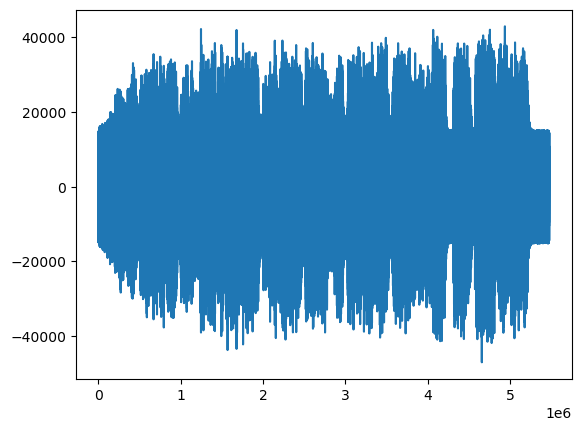

In [42]:
plt.plot(corrupted_data)

In [43]:
write_sound('corrupted.wav', corrupted_data, info)

In [44]:
Audio('./corrupted.wav')

In [48]:
ak = np.fft.ifft(corrupted_data)
ak

array([0.12110521+0.j        , 0.0881525 +0.00935201j,
       0.09255609-0.00197829j, ..., 0.1020082 +0.00578055j,
       0.09255609+0.00197829j, 0.0881525 -0.00935201j])

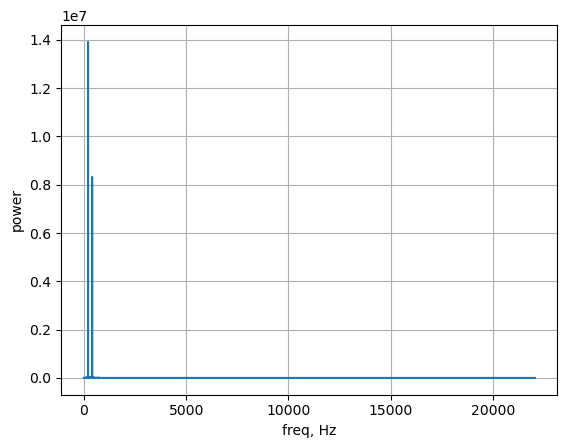

In [49]:
power = np.abs(ak)**2
nu = len(data)
freq = np.fft.fftfreq(len(data), 1.0/info.framerate)
plt.plot(freq[1:nu//2], power[1:nu//2])
plt.xlabel('freq, Hz')
plt.ylabel('power')
plt.grid()

(0.0, 4000.0, -125.0, 100.0)

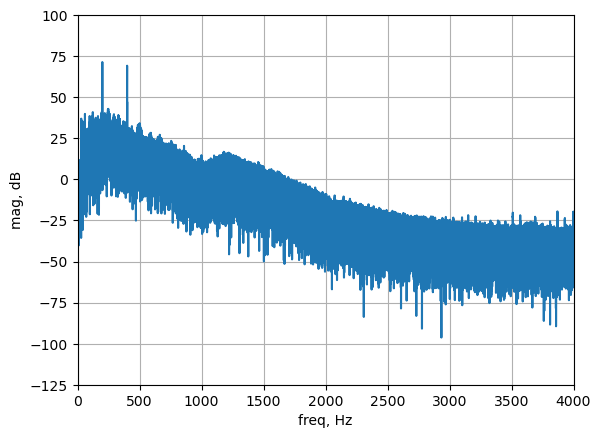

In [56]:
mag_dB = 20*np.log10(np.abs(ak))
freq = np.fft.fftfreq(len(data), 1.0/info.framerate)
plt.plot(freq[1:nu//2], mag_dB[1:nu//2])
plt.xlabel('freq, Hz')
plt.ylabel('mag, dB')
plt.grid()
plt.axis([0, 4000, -125, 100])

In [79]:
ak_new = np.copy(ak)
#ak_new[np.abs(freq) < 410] = np.finfo(np.float32).eps # remove tuba sound, high pass
#ak_new[np.abs(freq) > 5000] = np.finfo(np.float32).eps  # remove noise

#ak_new[np.abs(np.abs(freq) - 200) < 1] = np.finfo(np.float32).eps
#ak_new[np.abs(np.abs(freq) - 400) < 1] = np.finfo(np.float32).eps

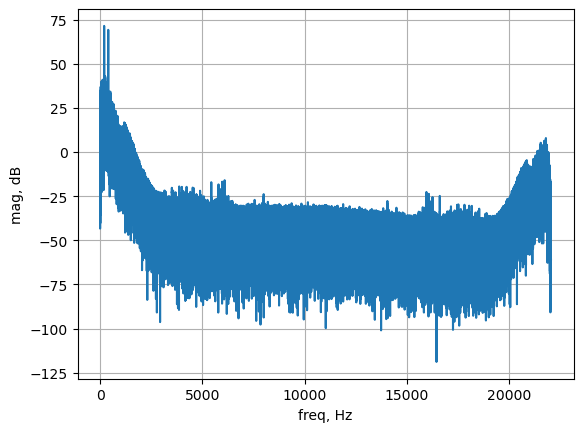

In [80]:
mag_dB = 20*np.log10(np.abs(ak_new))
freq = np.fft.fftfreq(len(data), 1.0/info.framerate)
plt.plot(freq[1:nu//2], mag_dB[1:nu//2])
plt.xlabel('freq, Hz')
plt.ylabel('mag, dB')
plt.grid()

In [81]:
data_new = np.real(np.fft.fft(ak_new))

In [82]:
write_sound('data/out.wav', data_new, info, signed=True) # note for your homework, you should set signed to False

In [83]:
Audio('./data/out.wav')

You can't hear the tuba anymore.